In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import plotly
import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

from sklearn.model_selection import TimeSeriesSplit

import statsmodels
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa import stattools

import os


In [ ]:
# Task:
# Time series prediction of weather data.
# check stationarity (random vs. autoregressive) of data
# create time based features
# model data and calculate remainder
# check remainder for autocorrelation and create time-lag feature(s)
# model remainder and lagged-data
# sum both models
# calculate remainder again and check for stationarity 

In [2]:
# function for printing the Augmented Dickey Fuller Test

def print_adf(data):
    
    """ Prints the results of the augmented Dickey Fuller Test"""
    
    adf_stats, p, used_lag, n_obs, levels, information_criterion = \
            statsmodels.tsa.stattools.adfuller(data)
    
    print(f"""   
            adf: {round(adf_stats,2)}
            p: {p} 
            used lag: {used_lag} 
            number of observations: {n_obs}
            {round(levels['1%'],2)} (p=0.01; CI=99%) 
            {round(levels['5%'],2)} (p=0.05; CI=95%)
            {round(levels['10%'],2)} (p=0.1 CI=90%) 
            information criterion (AIC): {information_criterion}
            """)
   

In [3]:
# read-in data from csv, correct temperature to deg-celcius, exclude -9999 values, create date based features

df = pd.read_csv('./ECA_blended_custom/TG_STAID002759.txt', sep=',', skiprows=19, parse_dates=[1])
df.columns = df.columns.str.replace(' ', '')
df['TG'] = df['TG']/10
df = df[['DATE', 'TG']]
df = df[df['TG'] > -100]
df['Month'] = df['DATE'].dt.month
df['Year'] = df['DATE'].dt.year
#df['Month'] = df['DATE'].dt.month
df.shape

(53435, 4)

In [4]:
# overview plot (zoomable)

px.line(data_frame=df, x='DATE', y='TG')

In [5]:
# Dickey Fuller Test

print_adf(df['TG'])

   
            adf: -20.47
            p: 0.0 
            used lag: 58 
            number of observations: 53376
            -3.43 (p=0.01; CI=99%) 
            -2.86 (p=0.05; CI=95%)
            -2.57 (p=0.1 CI=90%) 
            information criterion (AIC): 239202.6952673081
            


In [8]:
# one hot encoding of months, transform column-names to integers

ohe_month = pd.get_dummies(df['Month'])
df2 = df.join(ohe_month)
df2.drop(['Month',12], axis=1, inplace=True)
df2.columns = df2.columns.astype(str)
#df2.set_index('DATE', drop=True, inplace=True)
df2.sample(5)

,DATE,TG,Year,1,2,3,4,5,6,7,8,9,10,11
8218,1898-07-02,16.4,1898,0,0,0,0,0,0,1,0,0,0,0
32939,1966-03-09,5.5,1966,0,0,1,0,0,0,0,0,0,0,0
22025,1936-04-21,4.5,1936,0,0,0,1,0,0,0,0,0,0,0
7987,1897-11-13,3.6,1897,0,0,0,0,0,0,0,0,0,0,1
36431,1975-09-30,19.4,1975,0,0,0,0,0,0,0,0,1,0,0


In [10]:
# split up in X and y, fit model and make predictions

X = df2.drop(['TG','DATE'], axis=1)
y = df2['TG']

model = LinearRegression()
model.fit(X,y)
y_hat = model.predict(X)

df2['y_hat_lin'] = y_hat

In [11]:
# plot of predicted data

px.line(data_frame=df2, x='DATE', y=['TG','y_hat_lin'])

In [12]:
# calculate the remainder (difference between prediction and real value)

df2['Remainder'] = df2['TG'] - df2['y_hat_lin']

In [13]:
# plot remainder

px.line(data_frame=df2, x='DATE', y=['Remainder'])

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning:

The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.



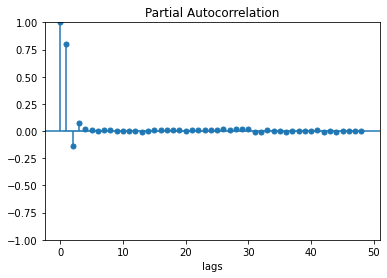

In [14]:
# find out how many lags to use for autocorrelated model for the remainder

from statsmodels.graphics.tsaplots import plot_pacf
plot_pacf(df2['Remainder'])
plt.xlabel('lags');

In [15]:
# create data with lag=1 and drop created nans

df2['lag1'] = df2['Remainder'].shift(1)
df2.dropna(inplace=True)
df2

,DATE,TG,Year,1,2,3,4,5,6,7,8,9,10,11,y_hat_lin,Remainder,lag1
1,1876-01-02,2.5,1876,1,0,0,0,0,0,0,0,0,0,0,-0.881305,3.381305,3.081305
2,1876-01-03,0.3,1876,1,0,0,0,0,0,0,0,0,0,0,-0.881305,1.181305,3.381305
3,1876-01-04,-5.8,1876,1,0,0,0,0,0,0,0,0,0,0,-0.881305,-4.918695,1.181305
4,1876-01-05,-9.8,1876,1,0,0,0,0,0,0,0,0,0,0,-0.881305,-8.918695,-4.918695
5,1876-01-06,-7.7,1876,1,0,0,0,0,0,0,0,0,0,0,-0.881305,-6.818695,-8.918695
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53625,2022-10-27,14.7,2022,0,0,0,0,0,0,0,0,0,1,0,10.428688,4.271312,2.171312
53626,2022-10-28,17.0,2022,0,0,0,0,0,0,0,0,0,1,0,10.428688,6.571312,4.271312
53627,2022-10-29,16.9,2022,0,0,0,0,0,0,0,0,0,1,0,10.428688,6.471312,6.571312
53628,2022-10-30,15.3,2022,0,0,0,0,0,0,0,0,0,1,0,10.428688,4.871312,6.471312


In [16]:
# check remainder for stationarity

print_adf(df2['Remainder'])

   
            adf: -23.81
            p: 0.0 
            used lag: 58 
            number of observations: 53375
            -3.43 (p=0.01; CI=99%) 
            -2.86 (p=0.05; CI=95%)
            -2.57 (p=0.1 CI=90%) 
            information criterion (AIC): 240693.1949607166
            


In [17]:
# train and predict model 2 for remainder with lag 1

X2 = df2[['lag1']]
y2 = df2['Remainder']
model2 = LinearRegression()
model2.fit(X2, y2)
df2['y_hat_rem_lag1'] = model2.predict(X2)

In [18]:
# calculate sum of both models (seasonal and remainder)

df2['sum_prediction'] = df2['y_hat_lin'] + df2['y_hat_rem_lag1']

In [19]:
# plot predictions that are the sum of both models

px.line(data_frame=df2, x='DATE', y=['TG','sum_prediction'])

In [20]:
# calculate remainder of remainder and check for stationarity

df2['remainder_2'] = df2['TG'] - df2['sum_prediction']

print_adf(df2['remainder_2'])

   
            adf: -34.55
            p: 0.0 
            used lag: 34 
            number of observations: 53399
            -3.43 (p=0.01; CI=99%) 
            -2.86 (p=0.05; CI=95%)
            -2.57 (p=0.1 CI=90%) 
            information criterion (AIC): 240717.9522211429
            
